In [1]:
from pathlib import Path
import matplotlib.pyplot as plt

import cv2 as cv
from fastai.vision.all import get_image_files
import pandas as pd
import numpy as np
import re
from math import ceil

In [2]:
%matplotlib inline
plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['figure.dpi'] = 150

In [3]:
im_path = Path('data/pic/src/orig/neu')

In [4]:
fnames = get_image_files(im_path)
fn = fnames[5]

In [5]:
list(fnames)[:5]

[Path('data/pic/src/orig/neu/ok/LED_correct_beige_03.JPG'),
 Path('data/pic/src/orig/neu/ok/LED_correct_beige2_62.JPG'),
 Path('data/pic/src/orig/neu/ok/LED_correct_beige2_76.JPG'),
 Path('data/pic/src/orig/neu/ok/LED_correct_beige2_23.JPG'),
 Path('data/pic/src/orig/neu/ok/LED_correct_beige_12.JPG')]

In [6]:
def fill_zero(fn, targ_digs):
    if type(fn) == str:
        x = fn
    else :
        x = str(fn)
    
    #finds = re.search(r'.*/*(.*_)(\d+).JPG', x)
    finds = re.search(r'(.*_)(\d+).JPG', x)
    no = finds.group(2)
    
    digs = list(no)
    cur_digs = len(digs)
    
    if cur_digs < targ_digs:
        for i in range(targ_digs - cur_digs):
            digs = ['0'] + digs
            
    return (finds.group(1) + ''.join(digs))

In [7]:
fnames.sort(key = lambda x: fill_zero(x, 3))
list(fnames)[:5]

[Path('data/pic/src/orig/neu/not_ok/LED_correct_beige2_01.JPG'),
 Path('data/pic/src/orig/neu/not_ok/LED_correct_beige2_02.JPG'),
 Path('data/pic/src/orig/neu/not_ok/LED_correct_beige2_05.JPG'),
 Path('data/pic/src/orig/neu/not_ok/LED_correct_beige2_06.JPG'),
 Path('data/pic/src/orig/neu/not_ok/LED_correct_beige2_08.JPG')]

In [8]:
df = pd.read_csv('data/led_new.csv', index_col = 0)

In [9]:
df.head()

,fname,y1,y2,x1,x2,project,label,background,angle,orientation,groups
0,LED_correct_beige2_01.JPG,130.574267,2941.606525,734.228959,5231.880572,LED,correct,beige2,side,R,29
1,LED_correct_beige2_02.JPG,311.542009,3050.187170,854.874120,5236.706378,LED,correct,beige2,top,R,29
2,LED_correct_beige2_03.JPG,58.187170,2917.477493,828.332184,5403.196701,LED,correct,beige2,side,L,29
3,LED_correct_beige2_04.JPG,420.122654,3038.122654,707.687023,4896.487023,LED,correct,beige2,top,L,29
4,LED_correct_beige2_05.JPG,58.187170,3170.832332,97.222507,5077.454765,LED,correct,beige2,side,L,30


In [11]:
df[['project', 'label', 'background']] = df['fname'].str.extract(r'(.*)_(.*)_(.*)_\d*.JPG')

In [13]:
df.sort_values('fname', key = lambda x: np.vectorize(fill_zero)(x, 3), inplace = True)
df.reset_index(drop = True, inplace = True)

In [14]:
df.head()

,fname,y1,y2,x1,x2,project,label,background
0,LED_correct_beige2_01.JPG,130.574267,2941.606525,734.228959,5231.880572,LED,correct,beige2
1,LED_correct_beige2_02.JPG,311.542009,3050.187170,854.874120,5236.706378,LED,correct,beige2
2,LED_correct_beige2_03.JPG,58.187170,2917.477493,828.332184,5403.196701,LED,correct,beige2
3,LED_correct_beige2_04.JPG,420.122654,3038.122654,707.687023,4896.487023,LED,correct,beige2
4,LED_correct_beige2_05.JPG,58.187170,3170.832332,97.222507,5077.454765,LED,correct,beige2


## Angle

In [16]:
fnames = get_image_files(im_path)
dic = {fn.name: fn.parent.name for fn in fnames}
df['angle'] = df.apply(lambda x: dic[x['fname']], axis = 1)
df.head(2)

,fname,y1,y2,x1,x2,project,label,background,angle
0,LED_correct_beige2_01.JPG,130.574267,2941.606525,734.228959,5231.880572,LED,correct,beige2,side
1,LED_correct_beige2_02.JPG,311.542009,3050.187170,854.874120,5236.706378,LED,correct,beige2,top
2,LED_correct_beige2_03.JPG,58.187170,2917.477493,828.332184,5403.196701,LED,correct,beige2,side
3,LED_correct_beige2_04.JPG,420.122654,3038.122654,707.687023,4896.487023,LED,correct,beige2,top
4,LED_correct_beige2_05.JPG,58.187170,3170.832332,97.222507,5077.454765,LED,correct,beige2,side


In [17]:
#df.to_csv('data/led_new_meta.csv')

## Orientation

In [18]:
fnames = get_image_files(im_path)
dic = {fn.name: fn.parent.name for fn in fnames}
df['orientation'] = df.apply(lambda x: dic[x['fname']], axis = 1)
df.head(2)

,fname,y1,y2,x1,x2,project,label,background,angle,orientation
0,LED_correct_beige2_01.JPG,130.574267,2941.606525,734.228959,5231.880572,LED,correct,beige2,side,R
1,LED_correct_beige2_02.JPG,311.542009,3050.187170,854.874120,5236.706378,LED,correct,beige2,top,R
2,LED_correct_beige2_03.JPG,58.187170,2917.477493,828.332184,5403.196701,LED,correct,beige2,side,L
3,LED_correct_beige2_04.JPG,420.122654,3038.122654,707.687023,4896.487023,LED,correct,beige2,top,L
4,LED_correct_beige2_05.JPG,58.187170,3170.832332,97.222507,5077.454765,LED,correct,beige2,side,L


In [19]:
#df.to_csv('data/led_new_meta.csv')

## Groups

In [17]:
fnames = get_image_files(im_path)
dic = {fn.name: fn.parent.name for fn in fnames}
df['groups'] = df.apply(lambda x: dic[x['fname']], axis = 1)
df.head(2)

,fname,y1,y2,x1,x2,project,label,background,angle,orientation,groups
0,LED_correct_beige2_01.JPG,130.574267,2941.606525,734.228959,5231.880572,LED,correct,beige2,side,R,29
1,LED_correct_beige2_02.JPG,311.542009,3050.187170,854.874120,5236.706378,LED,correct,beige2,top,R,29


In [18]:
#df.to_csv('data/led_new_meta.csv')

## Usability

In [10]:
fnames = get_image_files(im_path)
dic = {fn.name: fn.parent.name for fn in fnames}
df['usability'] = df.apply(lambda x: dic[x['fname']], axis = 1)
df.head(2)

,fname,y1,y2,x1,x2,project,label,background,angle,orientation,groups,usability
0,LED_correct_beige2_01.JPG,130.574267,2941.606525,734.228959,5231.880572,LED,correct,beige2,side,R,29,not_ok
1,LED_correct_beige2_02.JPG,311.542009,3050.187170,854.874120,5236.706378,LED,correct,beige2,top,R,29,not_ok


In [11]:
#df.to_csv('data/led_new_meta.csv')

## Check redundancies in groups

Group no: 1


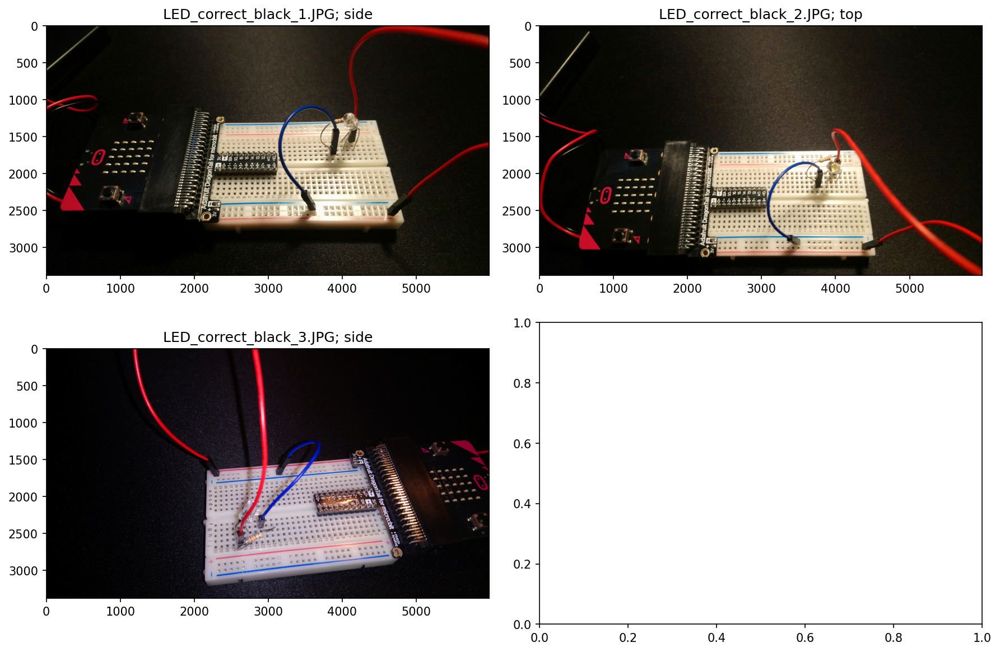

['LED_correct_black_1.JPG' 'LED_correct_black_2.JPG'
 'LED_correct_black_3.JPG']
Press Enter to continue
Group no: 2


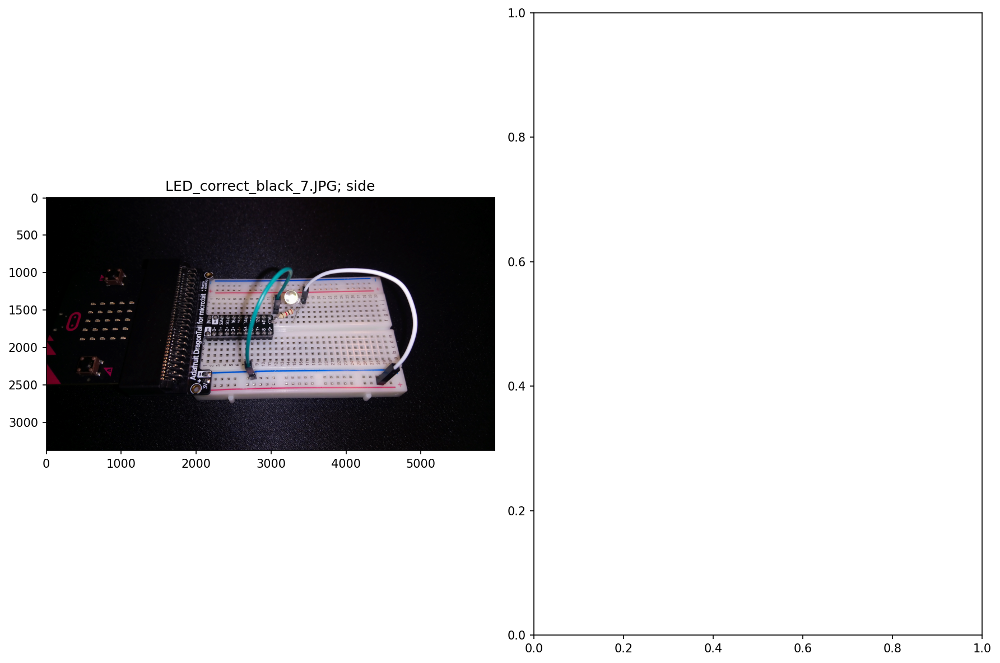

['LED_correct_black_7.JPG']
Press Enter to continue
Group no: 3


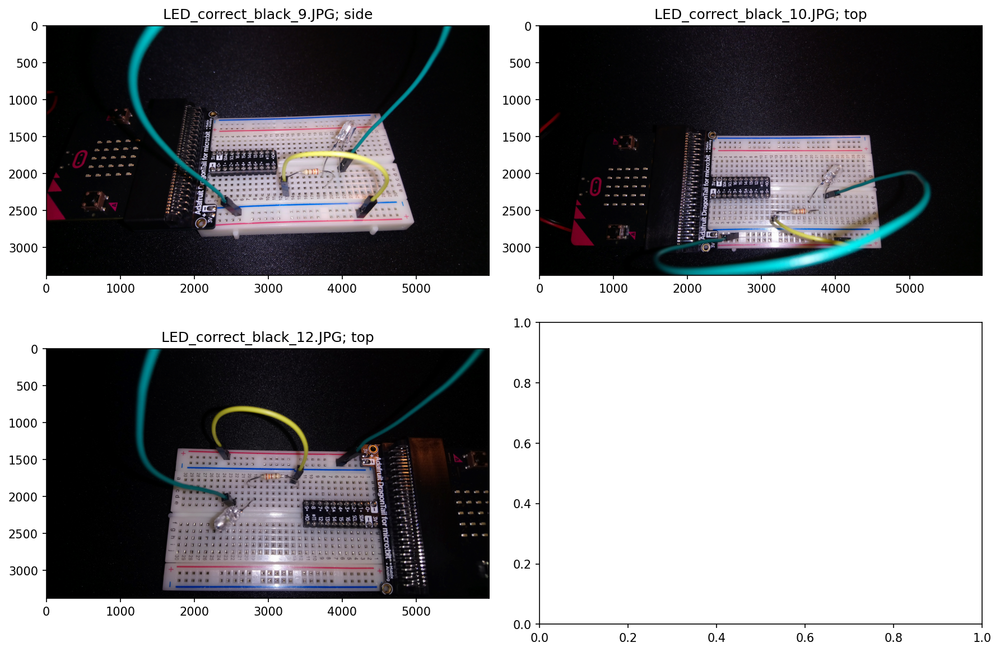

['LED_correct_black_9.JPG' 'LED_correct_black_10.JPG'
 'LED_correct_black_12.JPG']
Press Enter to continue
Group no: 4


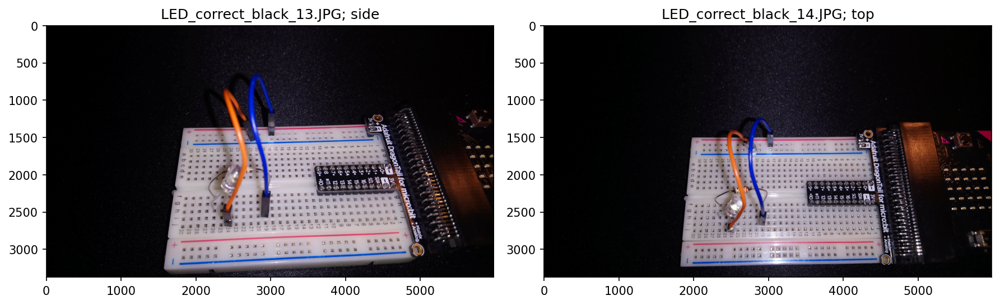

['LED_correct_black_13.JPG' 'LED_correct_black_14.JPG']
Press Enter to continue
Group no: 5


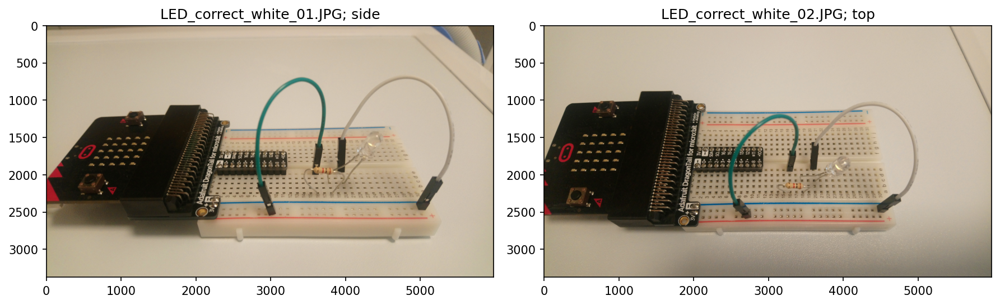

['LED_correct_white_01.JPG' 'LED_correct_white_02.JPG']
Press Enter to continue
Group no: 6


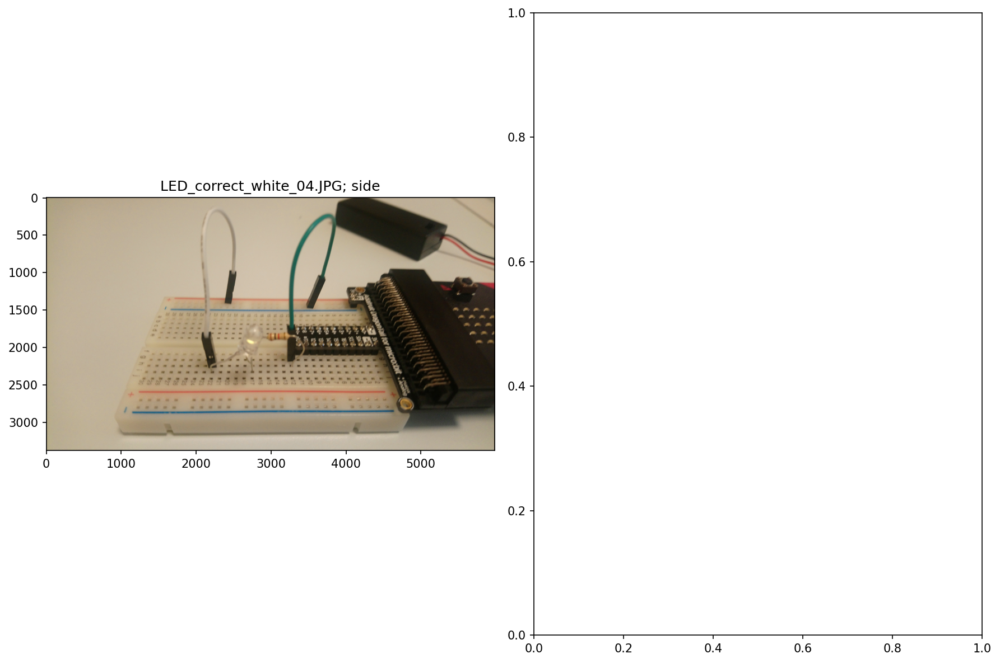

['LED_correct_white_04.JPG']
Press Enter to continue
Group no: 7


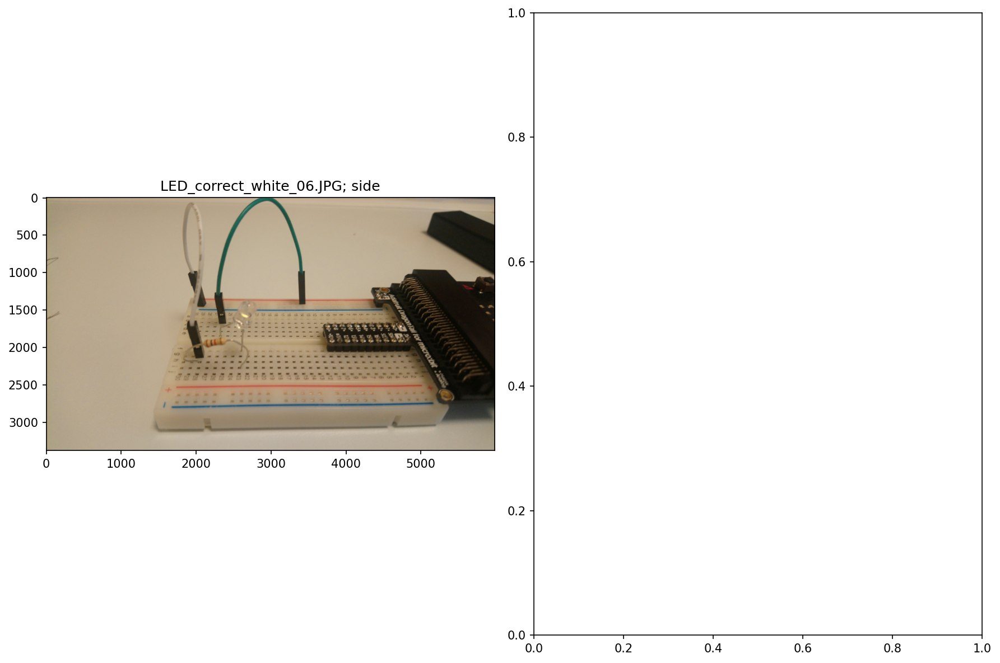

['LED_correct_white_06.JPG']
Press Enter to continue
Group no: 8
Group no: 9


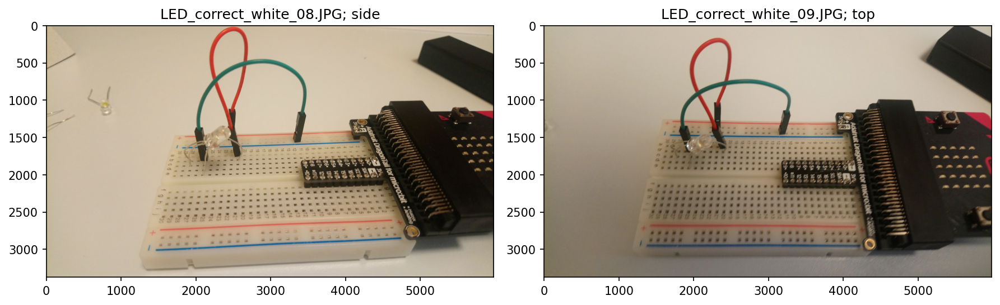

['LED_correct_white_08.JPG' 'LED_correct_white_09.JPG']
Press Enter to continue
Group no: 10


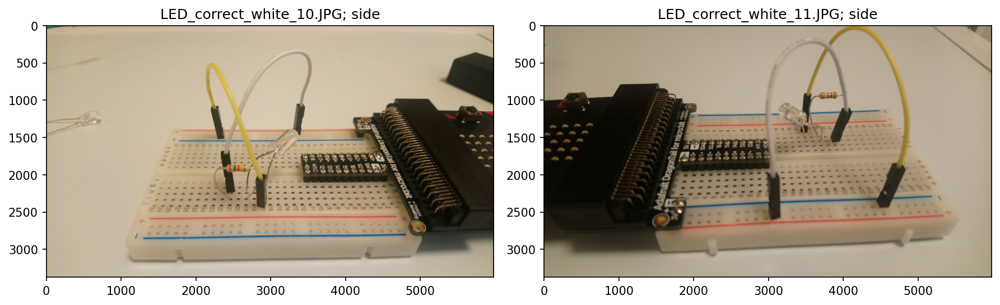

['LED_correct_white_10.JPG' 'LED_correct_white_11.JPG']
Press Enter to continue
Group no: 11


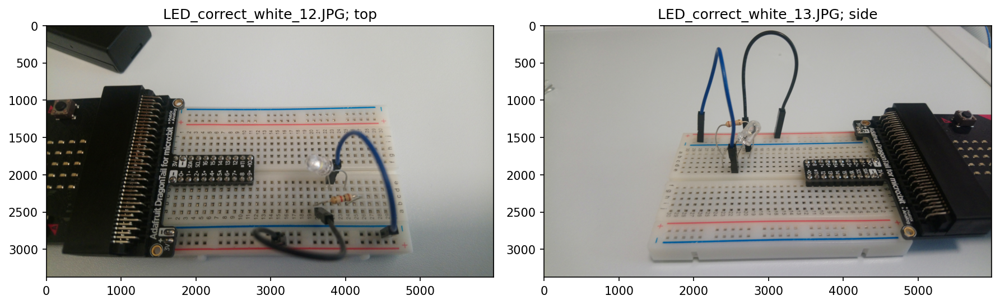

['LED_correct_white_12.JPG' 'LED_correct_white_13.JPG']
Press Enter to continue
Group no: 12


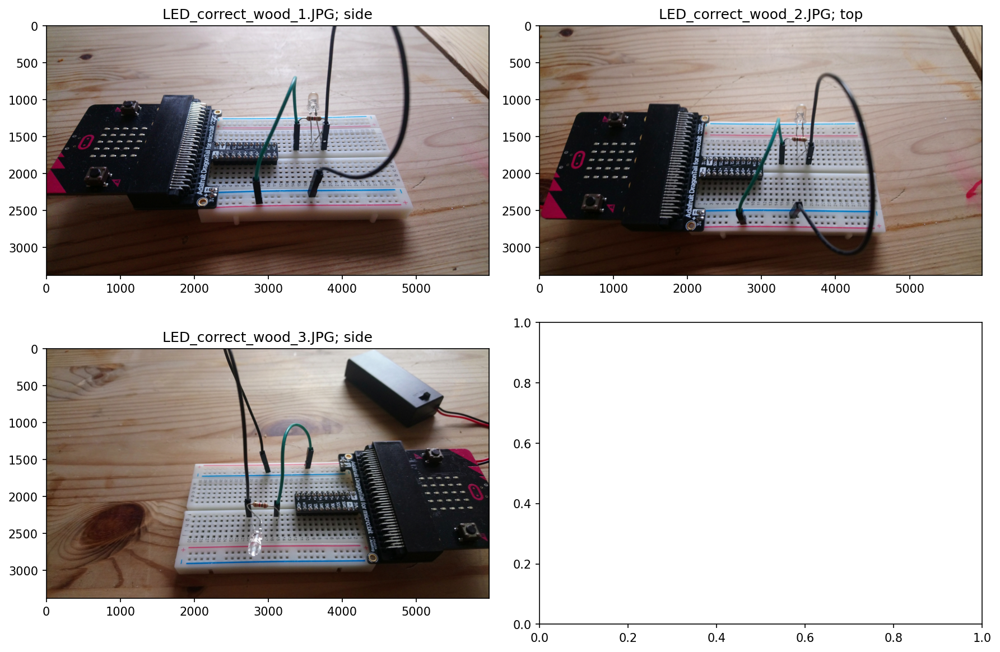

['LED_correct_wood_1.JPG' 'LED_correct_wood_2.JPG'
 'LED_correct_wood_3.JPG']
Press Enter to continue
Group no: 13


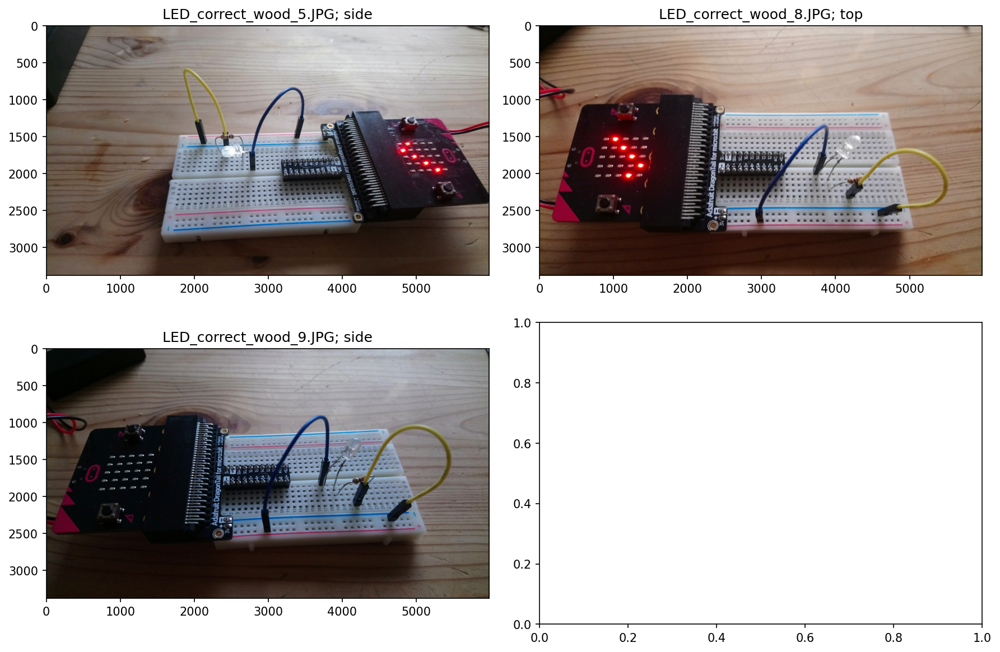

['LED_correct_wood_5.JPG' 'LED_correct_wood_8.JPG'
 'LED_correct_wood_9.JPG']
Press Enter to continue
Group no: 14


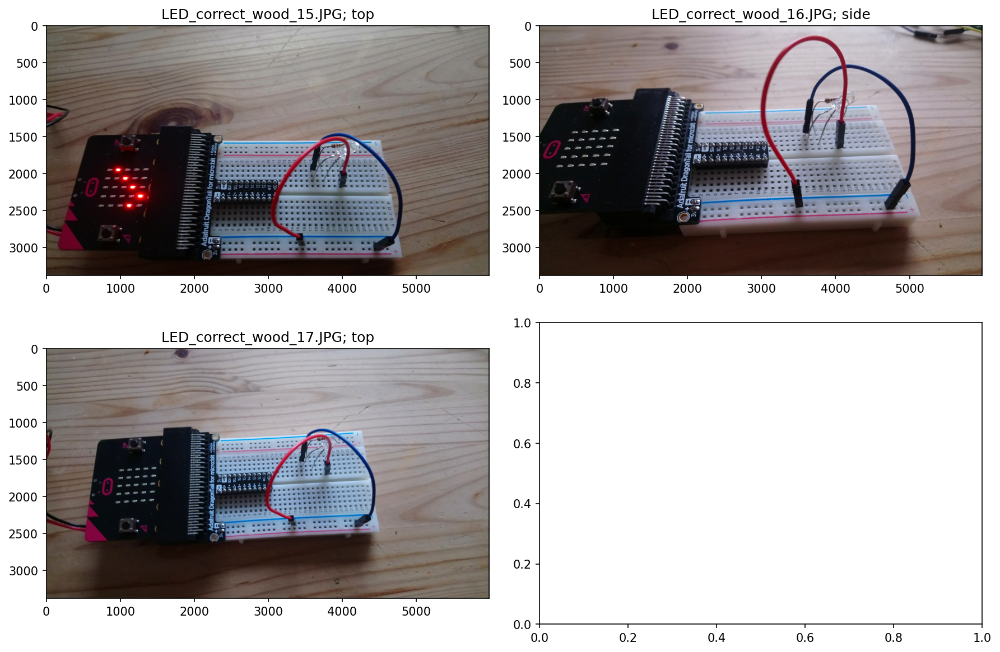

['LED_correct_wood_15.JPG' 'LED_correct_wood_16.JPG'
 'LED_correct_wood_17.JPG']
Press Enter to continue
Group no: 15


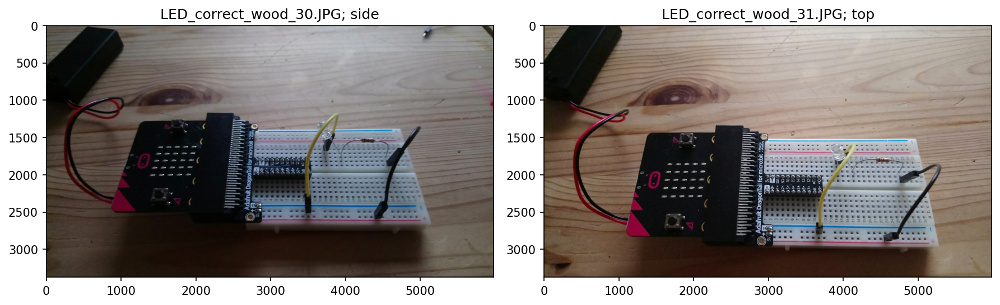

['LED_correct_wood_30.JPG' 'LED_correct_wood_31.JPG']
Press Enter to continue
Group no: 16


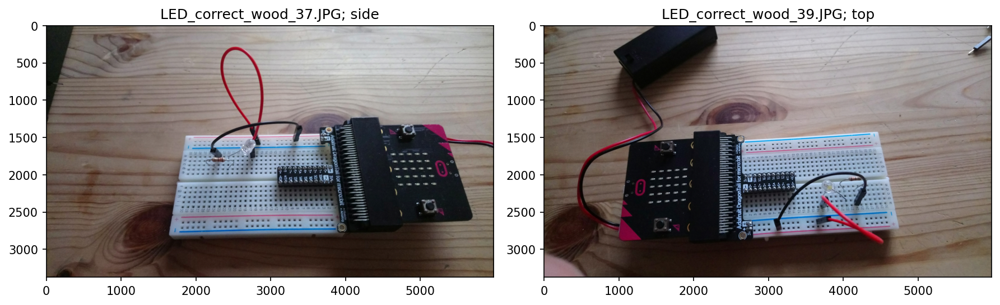

['LED_correct_wood_37.JPG' 'LED_correct_wood_39.JPG']
Press Enter to continue
Group no: 17


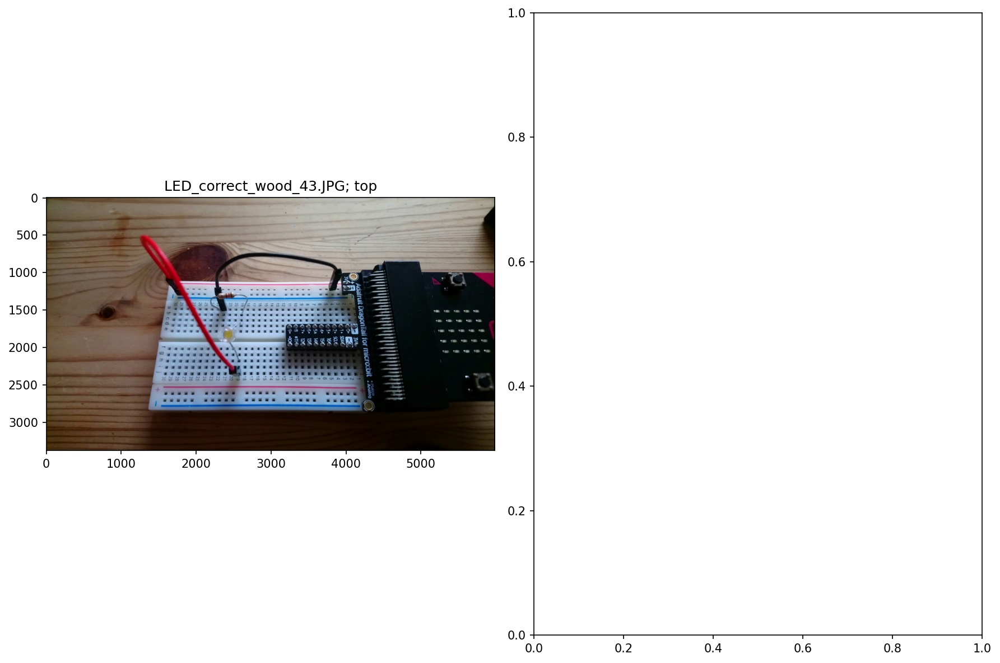

['LED_correct_wood_43.JPG']
Press Enter to continue
Group no: 18


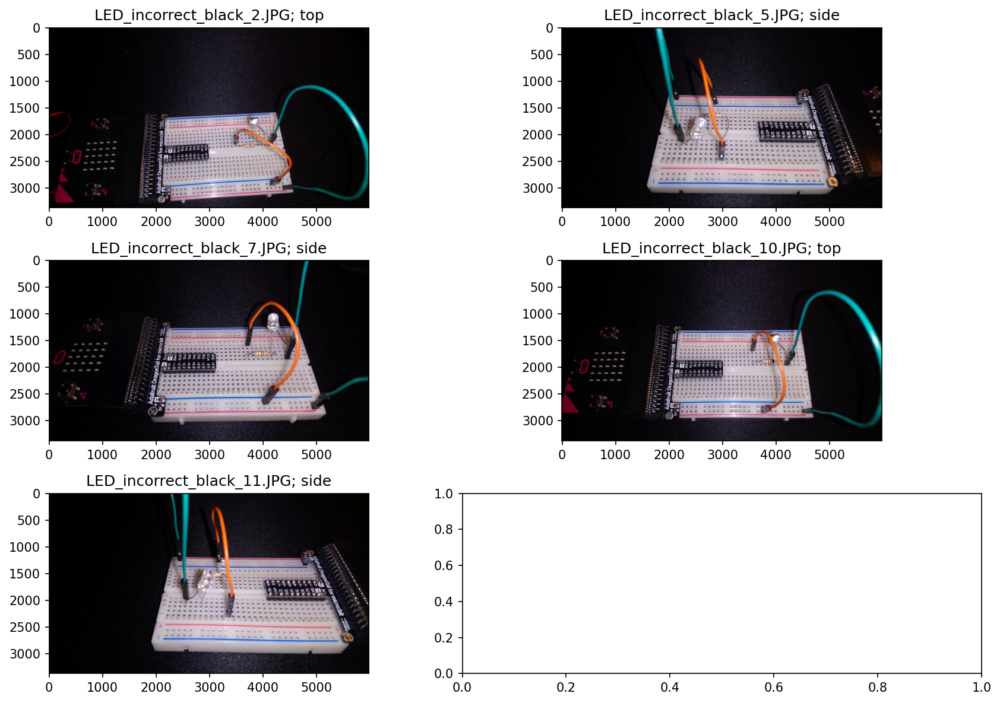

['LED_incorrect_black_2.JPG' 'LED_incorrect_black_5.JPG'
 'LED_incorrect_black_7.JPG' 'LED_incorrect_black_10.JPG'
 'LED_incorrect_black_11.JPG']
Press Enter to continue
Group no: 19


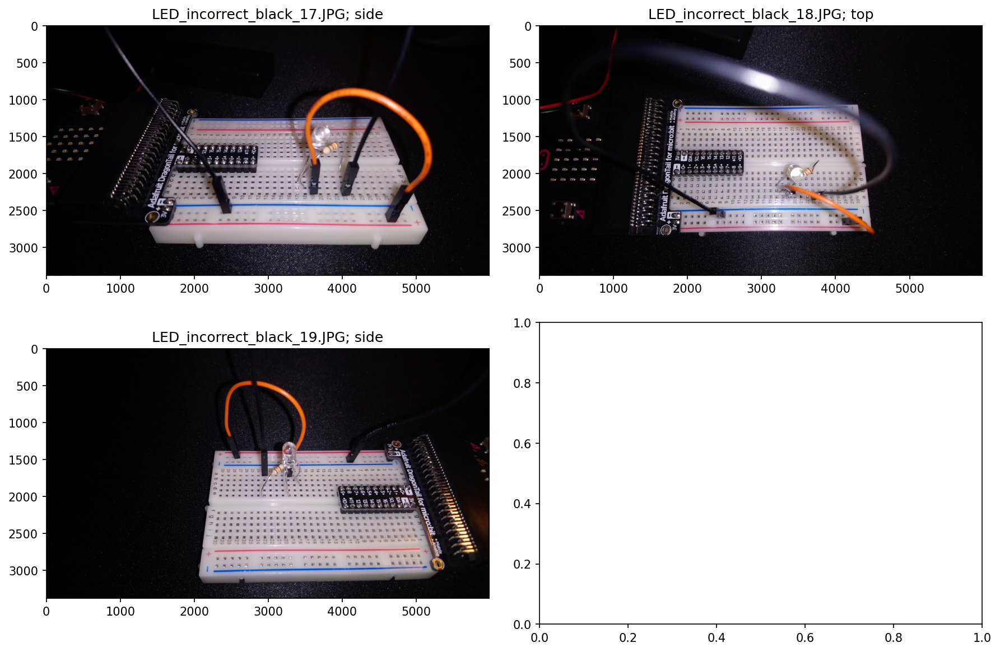

['LED_incorrect_black_17.JPG' 'LED_incorrect_black_18.JPG'
 'LED_incorrect_black_19.JPG']
Press Enter to continue
Group no: 20


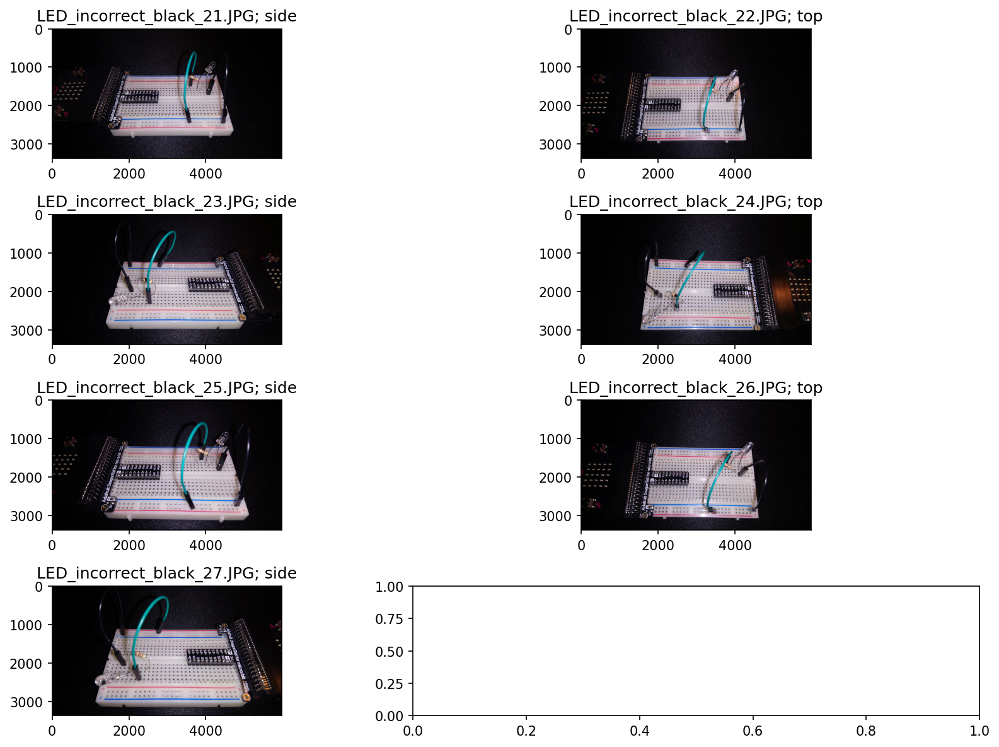

['LED_incorrect_black_21.JPG' 'LED_incorrect_black_22.JPG'
 'LED_incorrect_black_23.JPG' 'LED_incorrect_black_24.JPG'
 'LED_incorrect_black_25.JPG' 'LED_incorrect_black_26.JPG'
 'LED_incorrect_black_27.JPG']
Press Enter to continue
Group no: 21


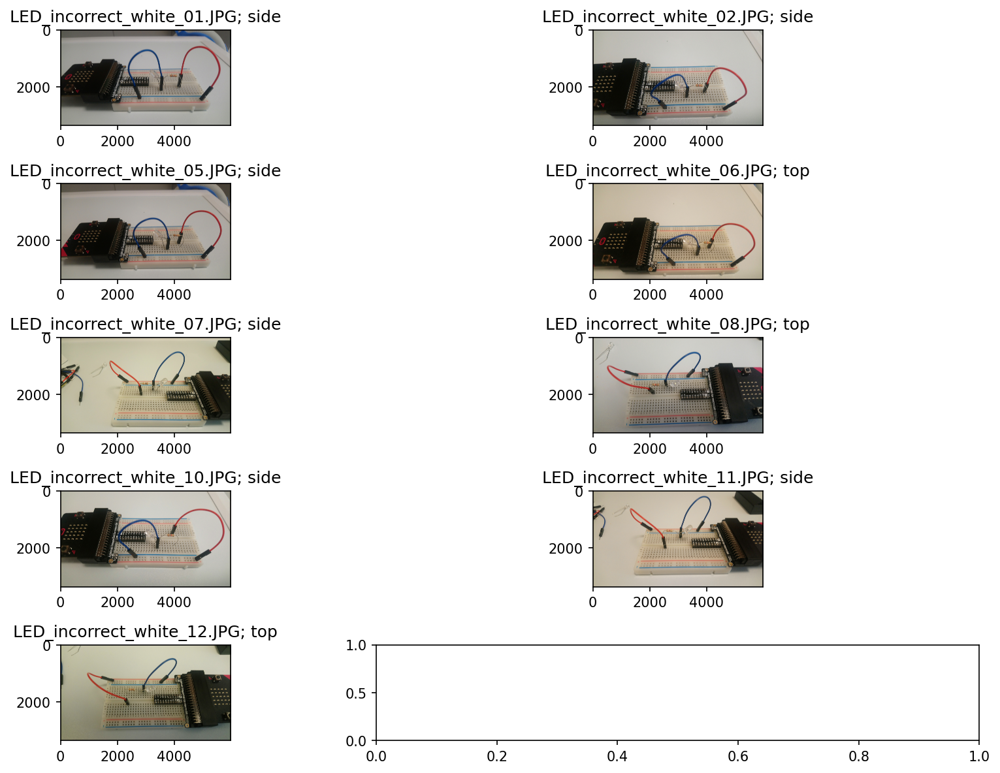

['LED_incorrect_white_01.JPG' 'LED_incorrect_white_02.JPG'
 'LED_incorrect_white_05.JPG' 'LED_incorrect_white_06.JPG'
 'LED_incorrect_white_07.JPG' 'LED_incorrect_white_08.JPG'
 'LED_incorrect_white_10.JPG' 'LED_incorrect_white_11.JPG'
 'LED_incorrect_white_12.JPG']
Press Enter to continue
Group no: 22


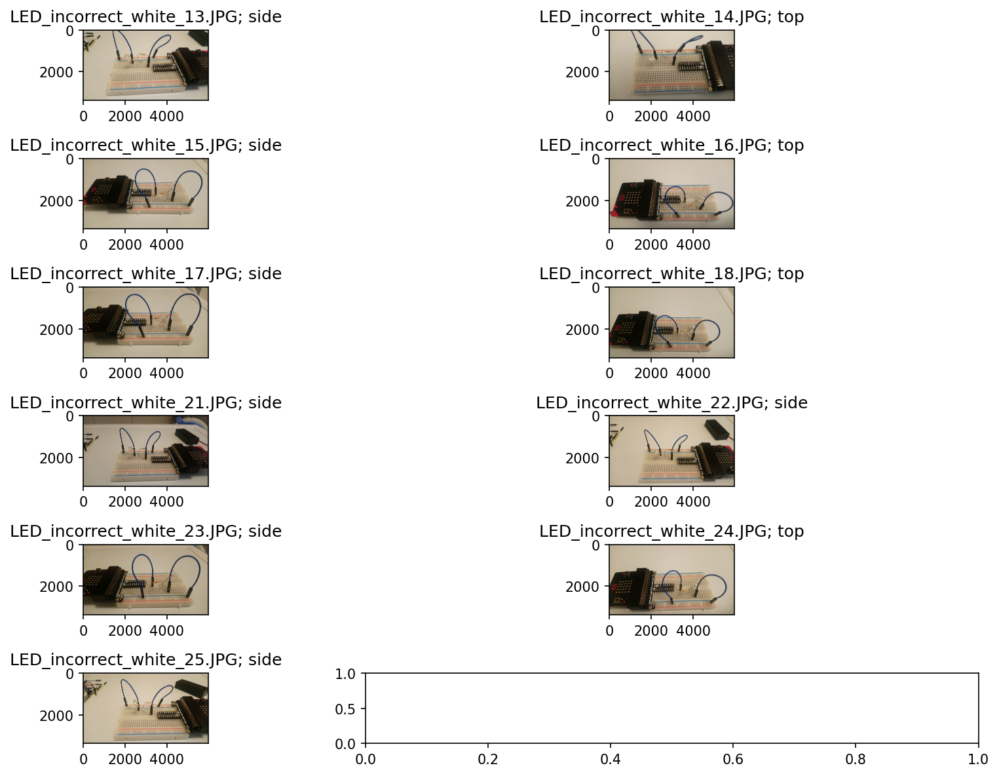

['LED_incorrect_white_13.JPG' 'LED_incorrect_white_14.JPG'
 'LED_incorrect_white_15.JPG' 'LED_incorrect_white_16.JPG'
 'LED_incorrect_white_17.JPG' 'LED_incorrect_white_18.JPG'
 'LED_incorrect_white_21.JPG' 'LED_incorrect_white_22.JPG'
 'LED_incorrect_white_23.JPG' 'LED_incorrect_white_24.JPG'
 'LED_incorrect_white_25.JPG']
Press Enter to continue
Group no: 23


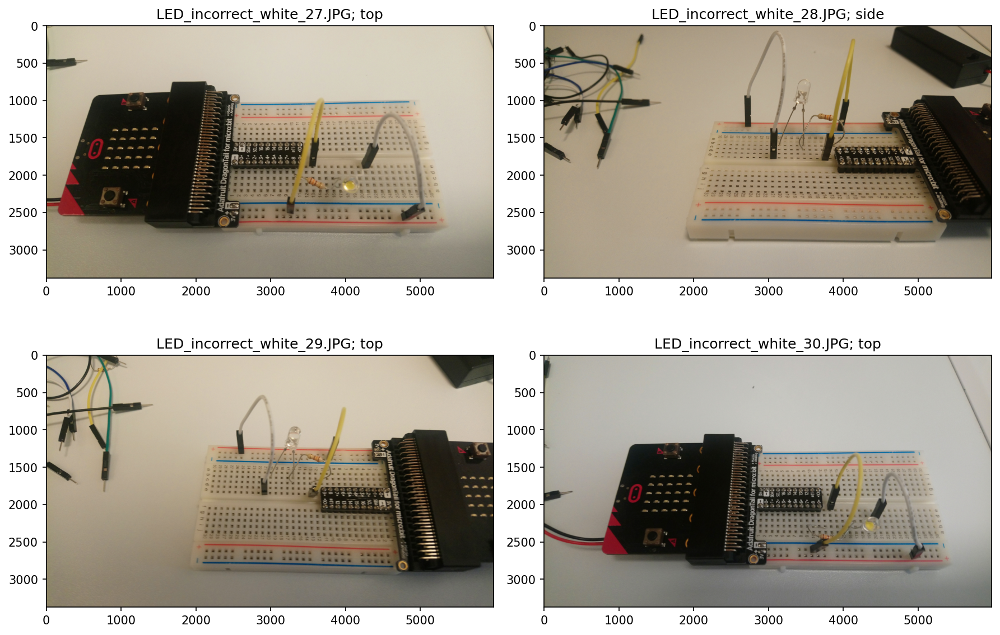

['LED_incorrect_white_27.JPG' 'LED_incorrect_white_28.JPG'
 'LED_incorrect_white_29.JPG' 'LED_incorrect_white_30.JPG']
Press Enter to continue
Group no: 24


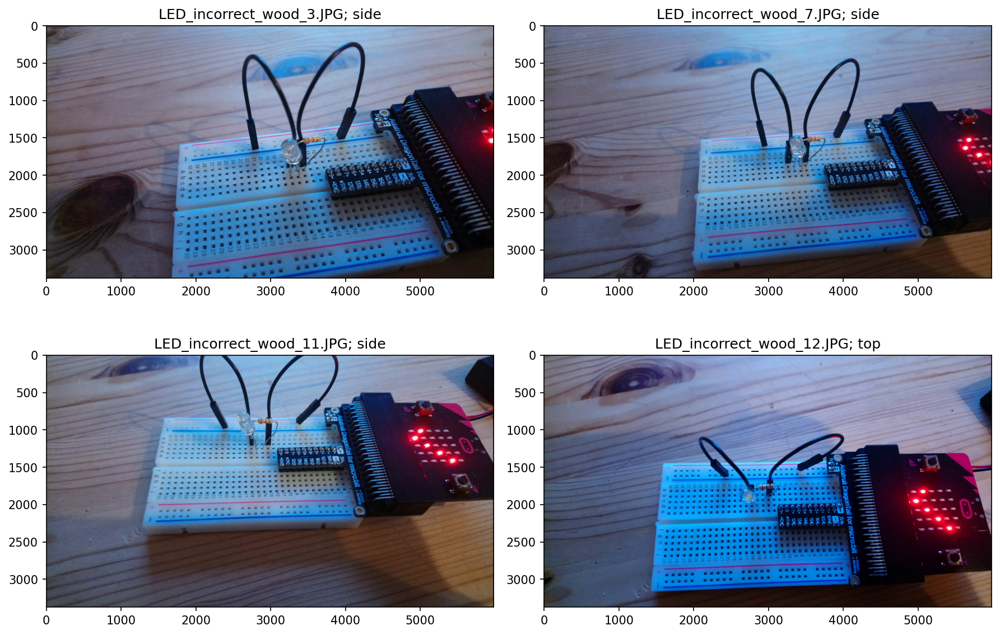

['LED_incorrect_wood_3.JPG' 'LED_incorrect_wood_7.JPG'
 'LED_incorrect_wood_11.JPG' 'LED_incorrect_wood_12.JPG']
Press Enter to continue
Group no: 25


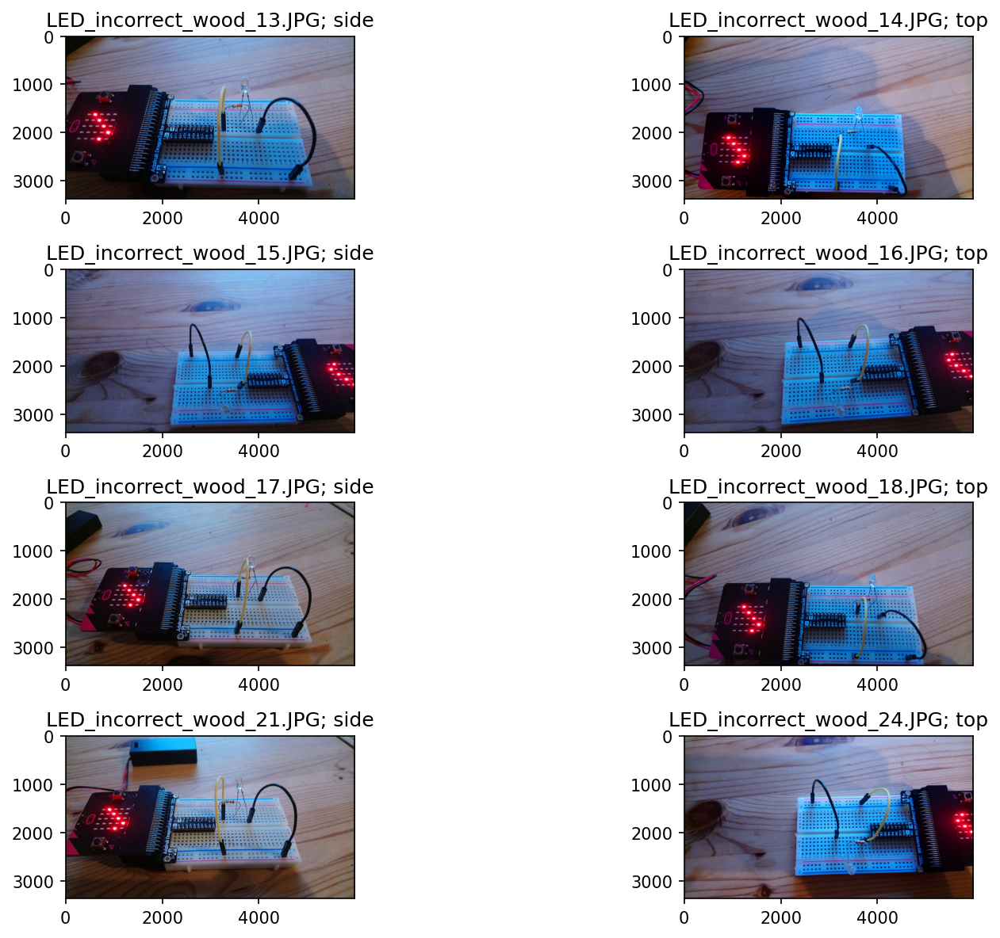

['LED_incorrect_wood_13.JPG' 'LED_incorrect_wood_14.JPG'
 'LED_incorrect_wood_15.JPG' 'LED_incorrect_wood_16.JPG'
 'LED_incorrect_wood_17.JPG' 'LED_incorrect_wood_18.JPG'
 'LED_incorrect_wood_21.JPG' 'LED_incorrect_wood_24.JPG']
Press Enter to continue
Group no: 26


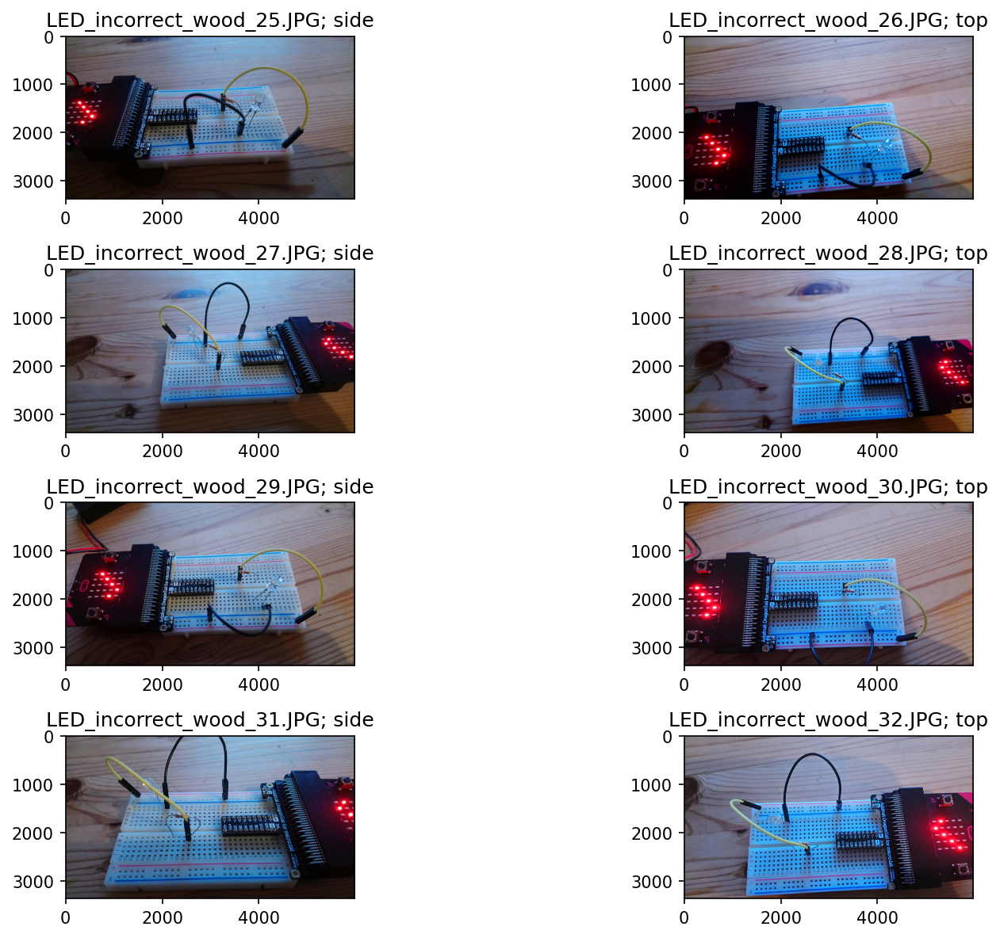

['LED_incorrect_wood_25.JPG' 'LED_incorrect_wood_26.JPG'
 'LED_incorrect_wood_27.JPG' 'LED_incorrect_wood_28.JPG'
 'LED_incorrect_wood_29.JPG' 'LED_incorrect_wood_30.JPG'
 'LED_incorrect_wood_31.JPG' 'LED_incorrect_wood_32.JPG']
Press Enter to continue
Group no: 27


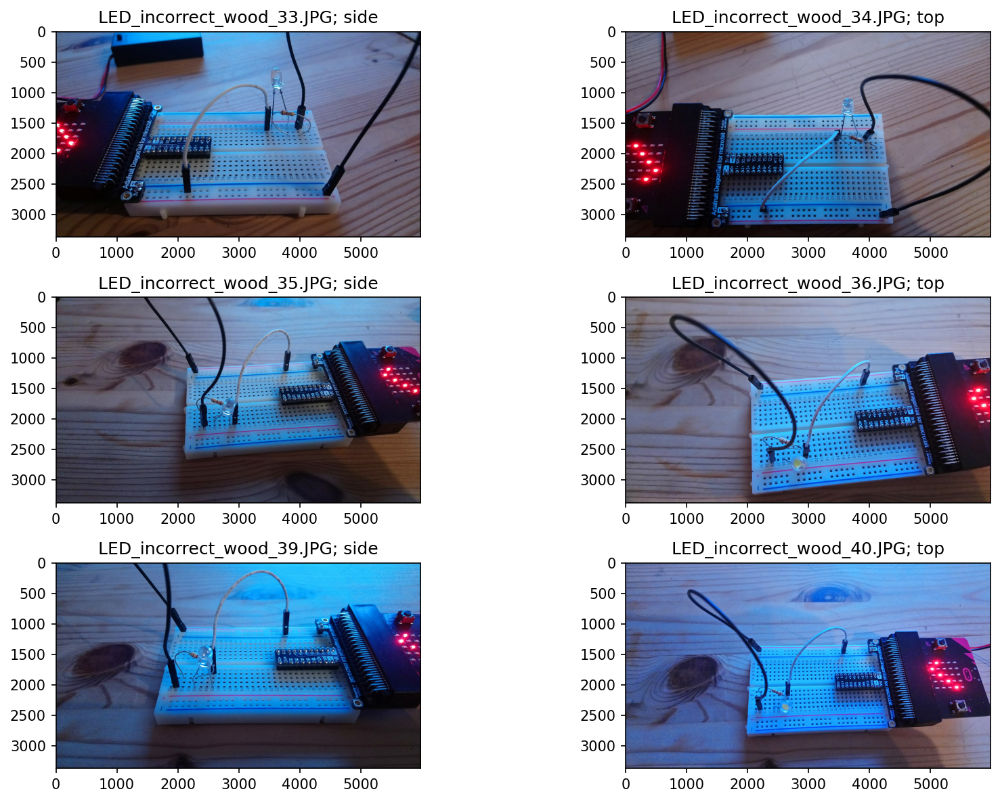

['LED_incorrect_wood_33.JPG' 'LED_incorrect_wood_34.JPG'
 'LED_incorrect_wood_35.JPG' 'LED_incorrect_wood_36.JPG'
 'LED_incorrect_wood_39.JPG' 'LED_incorrect_wood_40.JPG']
Press Enter to continue
Group no: 28


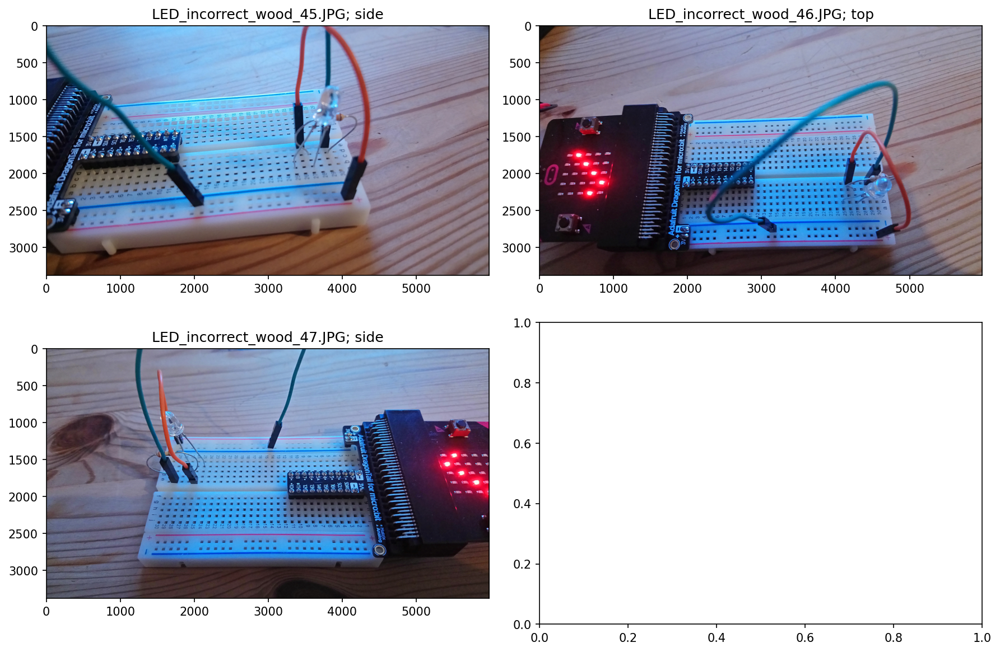

['LED_incorrect_wood_45.JPG' 'LED_incorrect_wood_46.JPG'
 'LED_incorrect_wood_47.JPG']
Press Enter to continue


In [52]:
# check for redundancy and if groups are assigned correctly
groups = df.groups.unique()

for group in groups:
    #if group < 12:
    #    continue
        
    print('Group no:', group)
    
    df_tmp = (df[(df.groups == group) & (df.usability == 'ok')]).reset_index()
    no_files = df_tmp.shape[0]
    
    if no_files < 1:
        continue
    
    no_rows = ceil(no_files / 2)
    
    fig, axs = plt.subplots(no_rows, 2)
    axs = axs.ravel()

    for i in range(no_files):
        fn, angle = df_tmp.loc[i,'name'], df_tmp.loc[i,'angle']
        im = plt.imread(im_path / fn)
        axs[i].set_title(fn + '; ' + angle)
        axs[i].imshow(im)
        
    plt.tight_layout()
    plt.show()
    print(df_tmp.name.values)
    input('Press Enter to continue')
    

In [53]:
rmv = ['LED_correct_wood_15.JPG', 'LED_incorrect_white_27.JPG'
      ] 
top = ['LED_incorrect_white_02.JPG', 'LED_incorrect_white_22.JPG'
      ]

In [56]:
df.loc[df.name.isin(rmv), 'usability'] = 'not_ok'
df.loc[df.name.isin(top), 'angle'] = 'top'

In [70]:
#df.to_csv('data/led_meta.csv')

In [61]:
df.head()

,name,y1,y2,x1,x2,project,label,background,orientation,angle,groups,usability
0,LED_correct_black_1.JPG,938.896848,2953.671041,1938.267668,5161.906378,LED,correct,black,L,side,1,ok
1,LED_correct_black_2.JPG,1493.864590,3279.412977,2051.674120,4908.551539,LED,correct,black,L,top,1,ok
2,LED_correct_black_3.JPG,1023.348461,3267.348461,1747.648313,5338.048313,LED,correct,black,R,side,1,ok
3,LED_correct_black_4.JPG,842.380719,3098.445235,1687.325733,5297.028959,LED,correct,black,R,top,1,not_ok
4,LED_correct_black_5.JPG,830.316203,3231.154912,1296.435410,5137.777346,LED,correct,black,R,side,2,not_ok
